In [1]:
!conda install -c conda-forge ta-lib -y

Channels:
 - conda-forge
Platform: linux-64
Solving environment: done


==> WARNING: A newer version of conda exists. <==
    current version: 25.5.0
    latest version: 25.5.1

Please update conda by running

    $ conda update -n base -c conda-forge conda



## Package Plan ##

  environment location: /opt/conda

  added / updated specs:
    - ta-lib


The following NEW packages will be INSTALLED:

  libta-lib          conda-forge/linux-64::libta-lib-0.4.0-hd590300_2 
  ta-lib             conda-forge/linux-64::ta-lib-0.4.32-py312hcc4bcb2_0 

The following packages will be UPDATED:

  ca-certificates                      2025.4.26-hbd8a1cb_0 --> 2025.7.9-hbd8a1cb_0 
  certifi                            2025.4.26-pyhd8ed1ab_0 --> 2025.7.9-pyhd8ed1ab_0 
  conda                              25.5.0-py312h7900ff3_0 --> 25.5.1-py312h7900ff3_0 
  openssl                                  3.5.0-h7b32b05_1 --> 3.5.1-h7b32b05_0 




Preparing transaction: done
Verifying transaction: done
Executi

In [2]:
!pip install vectorbt pandas pyarrow boto3 python-dateutil tqdm

In [37]:
import pandas as pd
import vectorbt as vbt
import boto3
import io
import numpy as np
from scipy.signal import find_peaks
import talib
from sklearn.cluster import DBSCAN
import plotly.graph_objects as go
from dateutil.relativedelta import relativedelta
from collections import Counter
from tqdm.notebook import tqdm

# ==============================================================================
# 1. 分析・バックテスト設定
# ==============================================================================
# デバッグモードのスイッチ (True: 詳細ログ表示 / False: 非表示)
DEBUG_MODE = False

# -- 時間足設定 --
TIMEFRAMES = ['D1', 'H4', 'H1', 'M30', 'M15', 'M5', 'M1']
EXECUTION_TIMEFRAME = 'M5'
FREQ_MAPPING = {
    'M1': '1min', 'M5': '5min', 'M15': '15min', 'M30': '30min',
    'H1': '1H', 'H4': '4H', 'D1': '1D'
}

# -- 通貨ペア --
SYMBOL = 'USDJPY'

# -- 期間設定 --
# バックテストを実行する開始日と終了日を文字列で指定
BACKTEST_START_DATE = '2025-01-01'
BACKTEST_END_DATE = None
# 終了日を None にすると、データセットの最後までを対象とします
# BACKTEST_END_DATE = None

# 1回の分析で参照するローソク足の本数
ANALYSIS_CANDLES = 500

# -- トレード戦略設定 --
# シグナルを記憶しておく期間（ローソク足の本数）
SIGNAL_LOOKBACK_PERIOD = 5 # 過去5本分のシグナルを考慮に入れる

RISK_REWARD_RATIO_THRESHOLD = 1.5
# 利益が初期リスクの何倍になったらトレイリングストップを開始するか
TRAILING_STOP_ACTIVATION_RR = 1.5
# 高値/安値から初期リスクの何倍の距離を保って追従するか
TRAILING_STOP_DISTANCE_RR = 1.5

# -- バックテスト資金設定 --
INITIAL_CAPITAL = 1_000_000
ORDER_SIZE_USD = 100_000

# -- テクニカル分析パラメータ --
DOW_PEAK_DISTANCE = 5
ZONE_PEAK_DISTANCE = 5
ZONE_EPS_MULTIPLIER = 0.001
ZONE_MIN_SAMPLES = 2
ADX_PERIOD = 14
ADX_STRONG_THRESHOLD = 25
MA_PERIOD = 20
SL_BUY_FACTOR = 0.998
SL_SELL_FACTOR = 1.002
# エントリー接触範囲のバッファ（パーセント）
# 0.001 = 0.1%。価格がラインの0.1%手前でも接触したと見なす
ENTRY_BUFFER_PERCENT = 0.001

print("✅ 設定完了")

✅ 設定完了


In [38]:
# ==============================================================================
# 2. データ取得・分析・実行の関数群
# ==============================================================================
def load_data_from_s3(timeframe, symbol):
    """S3から指定した通貨ペア・時間足のデータを読み込む"""
    s3_prefix = f'symbol={symbol}/timeframe={timeframe}/'
    print(f"--- {timeframe}データ読み込み中 ---")
    try:
        s3_client = boto3.client('s3')
        bucket_name = 'tss-raw-data'
        response = s3_client.list_objects_v2(Bucket=bucket_name, Prefix=s3_prefix)
        if 'Contents' not in response: return None

        all_dfs = [pd.read_parquet(io.BytesIO(s3_client.get_object(Bucket=bucket_name, Key=obj['Key'])['Body'].read())) 
                   for obj in response['Contents'] if obj['Key'].endswith('.parquet')]

        if not all_dfs: return None

        df = pd.concat(all_dfs, ignore_index=True).sort_values(by='timestamp_utc')
        return df.drop_duplicates(subset=['timestamp_utc'], keep='last').set_index('timestamp_utc')
    except Exception as e:
        print(f"Error loading data for {symbol}/{timeframe}: {e}")
        return None

def get_trend_environment(df, ma_period, adx_period, adx_threshold):
    """ダウ理論、移動平均線、ADXを用いてトレンドの方向と強さを判定する"""
    df = df.copy()

    # 1. ダウ理論によるトレンド判定（高値・安値の切り上げ/切り下げ）
    high_prominence = df['high'].std() * 0.2
    low_prominence = df['low'].std() * 0.2
    high_peaks, _ = find_peaks(df['high'], distance=DOW_PEAK_DISTANCE, prominence=high_prominence)
    low_peaks, _ = find_peaks(-df['low'], distance=DOW_PEAK_DISTANCE, prominence=low_prominence)

    recent_highs = df.iloc[high_peaks]['high'].tail(2)
    recent_lows = df.iloc[low_peaks]['low'].tail(2)

    is_uptrend_dow = (len(recent_highs) >= 2 and len(recent_lows) >= 2 and 
                      recent_highs.iloc[-1] > recent_highs.iloc[-2] and 
                      recent_lows.iloc[-1] > recent_lows.iloc[-2])

    is_downtrend_dow = (len(recent_highs) >= 2 and len(recent_lows) >= 2 and 
                        recent_highs.iloc[-1] < recent_highs.iloc[-2] and 
                        recent_lows.iloc[-1] < recent_lows.iloc[-2])

    # 2. 移動平均線によるフィルター
    ma = talib.SMA(df['close'], timeperiod=ma_period)
    is_above_ma = df['close'].iloc[-1] > ma.iloc[-1]

    # 3. ADXによるトレンド強度の判定
    adx = talib.ADX(df['high'], df['low'], df['close'], timeperiod=adx_period)
    trend_strength = "Weak/Ranging"
    if not pd.isna(adx.iloc[-1]) and adx.iloc[-1] > adx_threshold:
        trend_strength = "Strong"

    # 4. 全ての情報を統合して最終的なトレンドを決定
    trend_direction = "Range/Unclear"
    if is_uptrend_dow and is_above_ma:
        trend_direction = "Uptrend"
    elif is_downtrend_dow and not is_above_ma:
        trend_direction = "Downtrend"

    return {'direction': trend_direction, 'strength': trend_strength}

def get_support_resistance(df):
    """find_peaksとDBSCANクラスタリングを用いてサポート/レジスタンスゾーンを検出する"""
    df = df.copy()

    # 1. 意味のある価格転換点（スイングハイ/ロー）を検出
    prominence_threshold = df['high'].std() * 0.3
    high_peaks, _ = find_peaks(df['high'], distance=ZONE_PEAK_DISTANCE, prominence=prominence_threshold)
    low_peaks, _ = find_peaks(-df['low'], distance=ZONE_PEAK_DISTANCE, prominence=prominence_threshold)

    sig_highs_df = df.iloc[high_peaks]
    sig_lows_df = df.iloc[low_peaks]

    # 全ての転換点を一つのリストにまとめる
    sig_points = pd.concat([
        sig_highs_df[['high']].rename(columns={'high': 'price'}),
        sig_lows_df[['low']].rename(columns={'low': 'price'})
    ])

    zones = []
    isolated_lines = pd.DataFrame()

    # 2. DBSCAN(AI)を使い、価格が密集しているエリアを「ゾーン」としてグルーピング
    if len(sig_points) >= ZONE_MIN_SAMPLES:
        prices = sig_points['price'].values.reshape(-1, 1)
        # 探索半径(eps)は価格水準に応じて動的に変更
        eps = df['high'].mean() * ZONE_EPS_MULTIPLIER

        clustering = DBSCAN(eps=eps, min_samples=ZONE_MIN_SAMPLES).fit(prices)
        sig_points['label'] = clustering.labels_

        # クラスターをゾーンとして保存
        for label in set(clustering.labels_):
            if label != -1:  # -1はノイズ（孤立した点）
                zone_prices = sig_points[sig_points['label'] == label]['price']
                zones.append({'min': zone_prices.min(), 'max': zone_prices.max()})

        isolated_lines = sig_points[sig_points['label'] == -1]
    else:
        isolated_lines = sig_points

    # 3. 現在価格を基準に、ゾーンとラインをサポートとレジスタンスに分類
    current_price = df['close'].iloc[-1]

    supports_raw = [z['max'] for z in zones if z['max'] < current_price] + \
                   [p for p in isolated_lines['price'] if p < current_price]

    resistances_raw = [z['min'] for z in zones if z['min'] > current_price] + \
                      [p for p in isolated_lines['price'] if p > current_price]

    supports = sorted(supports_raw, reverse=True)
    resistances = sorted(resistances_raw)

    # グラフ描画用に詳細情報も返す
    details_for_plot = {
        "swing_highs": sig_highs_df,
        "swing_lows": sig_lows_df,
        "zones": zones
    }

    return supports, resistances, details_for_plot

def calculate_pivots(df):
    """前日の日足データからピボットポイントとS1/R1, S2/R2を計算する"""
    # データを日足にリサンプリング
    daily_df = df.resample('D').agg({
        'open': 'first',
        'high': 'max',
        'low': 'min',
        'close': 'last'
    }).dropna()

    # 前日の高値・安値・終値を取得
    prev_high = daily_df['high'].shift(1)
    prev_low = daily_df['low'].shift(1)
    prev_close = daily_df['close'].shift(1)

    # ピボットポイントを計算
    p = (prev_high + prev_low + prev_close) / 3
    r1 = 2 * p - prev_low
    s1 = 2 * p - prev_high
    r2 = p + (prev_high - prev_low)
    s2 = p - (prev_high - prev_low)

    # 計算結果を結合
    pivots_daily = pd.concat([p, s1, r1, s2, r2], axis=1)
    pivots_daily.columns = ['P', 'S1', 'R1', 'S2', 'R2']
    
    # 元のデータフレームのインデックスに日足ピボットをマッピング（前方フィル）
    pivots = pivots_daily.reindex(df.index, method='ffill')
    return pivots

def analyze_single_timeframe(df):
    """単一の時間足に対して、全分析を実行しピボットを統合する"""
    if df is None or len(df) < 50:
        return None
        
    # 既存の分析を実行
    environment = get_trend_environment(df, MA_PERIOD, ADX_PERIOD, ADX_STRONG_THRESHOLD)
    supports, resistances, plot_details = get_support_resistance(df)
    
    # ピボットを計算
    pivots = calculate_pivots(df)
    # 最新のピボット値を取得
    latest_pivots = pivots.iloc[-1].dropna().to_dict()
    
    current_price = df['close'].iloc[-1]
    
    # ピボットをサポートとレジスタンスに分類
    pivot_supports = [v for k, v in latest_pivots.items() if v < current_price]
    pivot_resistances = [v for k, v in latest_pivots.items() if v > current_price]
    
    # 既存のS/Rリストにピボットを統合し、重複を削除してソート
    combined_supports = sorted(list(set(supports + pivot_supports)), reverse=True)
    combined_resistances = sorted(list(set(resistances + pivot_resistances)))
    
    # 描画用にピボット情報も追加
    plot_details['pivots'] = latest_pivots
    
    return {
        'environment': environment,
        'supports': combined_supports,
        'resistances': combined_resistances,
        'details_for_plot': plot_details
    }

# =================================================
# ===== シグナル生成器 関数群 =====
# =================================================

def generate_sr_signal(current_candle, analysis_results):
    """サポート/レジスタンスへの接触シグナルを生成する"""
    if not analysis_results:
        return 0
    
    # 買いシグナル：サポートに接触
    if analysis_results['supports']:
        support_price = analysis_results['supports'][0]
        entry_trigger_price = support_price * (1 + ENTRY_BUFFER_PERCENT)
        if current_candle['low'] <= entry_trigger_price:
            return 1 # 買いシグナル
            
    # 売りシグナル：レジスタンスに接触
    if analysis_results['resistances']:
        resistance_price = analysis_results['resistances'][0]
        entry_trigger_price = resistance_price * (1 - ENTRY_BUFFER_PERCENT)
        if current_candle['high'] >= entry_trigger_price:
            return -1 # 売りシグナル
            
    return 0 # シグナルなし

def generate_rsi_signal(close_prices, period=14, oversold=30, overbought=70):
    """RSIのクロスシグナルを生成する"""
    if len(close_prices) < period + 2: return 0
    rsi = talib.RSI(close_prices, timeperiod=period)
    # 最新とその1つ前のRSI値
    last_rsi = rsi.iloc[-1]
    prev_rsi = rsi.iloc[-2]
    
    # 買いシグナル：売られすぎゾーンから上に抜けた
    if prev_rsi <= oversold and last_rsi > oversold:
        return 1
    # 売りシグナル：買われすぎゾーンから下に抜けた
    if prev_rsi >= overbought and last_rsi < overbought:
        return -1
    return 0

def generate_macd_signal(close_prices, fast=12, slow=26, signal=9):
    """MACDのクロスシグナルを生成する"""
    if len(close_prices) < slow + signal: return 0
    macd, macd_signal, _ = talib.MACD(close_prices, fastperiod=fast, slowperiod=slow, signalperiod=signal)
    # 最新とその1つ前の値
    last_macd, last_signal = macd.iloc[-1], macd_signal.iloc[-1]
    prev_macd, prev_signal = macd.iloc[-2], macd_signal.iloc[-2]

    # 買いシグナル：ゴールデンクロス
    if prev_macd <= prev_signal and last_macd > last_signal:
        return 1
    # 売りシグナル：デッドクロス
    if prev_macd >= prev_signal and last_macd < last_signal:
        return -1
    return 0

def generate_bb_signal(close_prices, period=20, std_dev=2):
    """ボリンジャーバンドのブレイクアウトシグナルを生成する"""
    if len(close_prices) < period:
        return 0
    
    upper, _, lower = talib.BBANDS(close_prices, timeperiod=period, nbdevup=std_dev, nbdevdn=std_dev)
    last_close = close_prices.iloc[-1]
    
    # 買いシグナル：アッパーバンドを上抜け（順張り）
    if last_close > upper.iloc[-1]:
        return 1
    # 売りシグナル：ロワーバンドを下抜け（順張り）
    elif last_close < lower.iloc[-1]:
        return -1
        
    return 0 # シグナルなし

# =================================================
# ===== 全シグナルを統合するテスト用関数 =====
# =================================================

def get_all_signals_for_test(df_slice):
    """指定されたデータ範囲の最新の足の全シグナルをまとめて取得する"""
    # 1. 従来のサポレジ分析を実行
    sr_analysis_results = analyze_single_timeframe(df_slice)
    
    # 2. 各シグナル生成器を呼び出す
    current_candle = df_slice.iloc[-1]
    close_prices = df_slice['close']
    
    sr_signal = generate_sr_signal(current_candle, sr_analysis_results)
    rsi_signal = generate_rsi_signal(close_prices)
    macd_signal = generate_macd_signal(close_prices)
    bb_signal = generate_bb_signal(close_prices)
    
    # 3. 結果を辞書にまとめて返す
    return {
        'S/R': sr_signal,
        'RSI': rsi_signal,
        'MACD': macd_signal,
        'BB': bb_signal
    }

print("✅ シグナル生成器の関数定義を追加しました。")

def run_backtest(df_exec, all_data):
    """【期間概念 導入版】過去N本のシグナルを考慮してエントリーする"""
    entries = pd.Series(False, index=df_exec.index)
    exits = pd.Series(False, index=df_exec.index)
    
    in_position = False
    active_trade = {}
    
    # --- デバッグ用カウンター ---
    entry_counter = Counter()
    exit_reason_counter = Counter()
    
    # --- 【NEW】シグナル履歴を保存するためのDataFrame ---
    signal_history = pd.DataFrame(index=df_exec.index, columns=['S/R', 'RSI', 'MACD', 'BB']).fillna(0)

    print("\n" + "="*50)
    print(f"【バックテストメインループ開始: {len(df_exec)}本】")
    
    for i in tqdm(range(ANALYSIS_CANDLES, len(df_exec)), desc="Backtesting Progress"):
        current_time = df_exec.index[i]
        current_candle = df_exec.iloc[i]
        
        # --- 決済ロジック (変更なし) ---
        if in_position:
            sl_price = active_trade['sl']
            trade_type = active_trade['type']
            is_closed = False
            exit_reason = ""

            if (trade_type == 'Buy' and current_candle['low'] <= sl_price) or \
               (trade_type == 'Sell' and current_candle['high'] >= sl_price):
                is_closed = True
                exit_reason = "Stop Loss"
            
            elif active_trade['exit_mode'] == 'fixed':
                tp_price = active_trade['tp']
                if (trade_type == 'Buy' and current_candle['high'] >= tp_price) or \
                   (trade_type == 'Sell' and current_candle['low'] <= tp_price):
                    is_closed = True
                    exit_reason = "Take Profit"
            
            elif active_trade['exit_mode'] == 'trailing':
                original_sl = sl_price
                if trade_type == 'Buy':
                    new_sl = current_candle['high'] - active_trade['trailing_distance']
                    if new_sl > original_sl:
                        if DEBUG_MODE: print(f"  -> TRAIL SL (Buy): {original_sl:.3f} -> {new_sl:.3f}")
                        active_trade['sl'] = new_sl
                elif trade_type == 'Sell':
                    new_sl = current_candle['low'] + active_trade['trailing_distance']
                    if new_sl < original_sl:
                        if DEBUG_MODE: print(f"  -> TRAIL SL (Sell): {original_sl:.3f} -> {new_sl:.3f}")
                        active_trade['sl'] = new_sl

            if is_closed:
                if DEBUG_MODE: print(f"    <<< EXIT EXECUTED: {exit_reason} at {current_time} >>>")
                exits.iloc[i] = True
                in_position = False
                active_trade = {}
                exit_reason_counter.update([exit_reason])
            continue

        # --- エントリーロジック ---
        # 1. 現在の足の全シグナルを生成し、履歴に保存
        df_slice = all_data[EXECUTION_TIMEFRAME].loc[:current_time].tail(ANALYSIS_CANDLES)
        if len(df_slice) < ANALYSIS_CANDLES: continue
        
        sr_analysis_results = analyze_single_timeframe(df_slice)
        close_prices = df_slice['close']
        
        signals = {
            'S/R': generate_sr_signal(current_candle, sr_analysis_results),
            'RSI': generate_rsi_signal(close_prices),
            'MACD': generate_macd_signal(close_prices),
            'BB': generate_bb_signal(close_prices)
        }
        signal_history.loc[current_time] = signals
        
        # 2. 過去N本分のシグナル履歴を取得
        lookback_slice = signal_history.iloc[i - SIGNAL_LOOKBACK_PERIOD + 1 : i + 1]
        
        # 3. 期間内の投票結果を集計
        buy_votes = sum(1 for col in lookback_slice.columns if (lookback_slice[col] == 1).any())
        sell_votes = sum(1 for col in lookback_slice.columns if (lookback_slice[col] == -1).any())

        if DEBUG_MODE and (buy_votes >= 2 or sell_votes >= 2):
            print(f"[{current_time}] Votes in last {SIGNAL_LOOKBACK_PERIOD} bars - Buy: {buy_votes}, Sell: {sell_votes}")

        # 4. エントリー判断
        # --- 買いエントリー検討 (買い票が2票以上) ---
        if buy_votes >= 2:
            support_price = sr_analysis_results['supports'][0] if sr_analysis_results and sr_analysis_results['supports'] else current_candle['low']
            stop_loss = support_price * SL_BUY_FACTOR
            risk = current_candle['close'] - stop_loss
            if risk <= 0: continue
            
            if sr_analysis_results and sr_analysis_results['resistances']:
                take_profit = sr_analysis_results['resistances'][0]
                reward = take_profit - current_candle['close']
                if (reward / risk) >= RISK_REWARD_RATIO_THRESHOLD:
                    entries.iloc[i] = True; in_position = True
                    active_trade = {'type': 'Buy', 'sl': stop_loss, 'tp': take_profit, 'exit_mode': 'fixed'}
                    entry_counter.update(['Buy (Fixed)'])
                    if DEBUG_MODE: print(f"    >>> ENTRY: Buy (Fixed) with {buy_votes} votes <<<")
            else:
                trailing_distance = risk * TRAILING_STOP_DISTANCE_RR
                entries.iloc[i] = True; in_position = True
                active_trade = {'type': 'Buy', 'sl': stop_loss, 'trailing_distance': trailing_distance, 'exit_mode': 'trailing'}
                entry_counter.update(['Buy (Trailing)'])
                if DEBUG_MODE: print(f"    >>> ENTRY: Buy (Trailing) with {buy_votes} votes <<<")

        # --- 売りエントリー検討 (売り票が2票以上) ---
        elif sell_votes >= 2:
            resistance_price = sr_analysis_results['resistances'][0] if sr_analysis_results and sr_analysis_results['resistances'] else current_candle['high']
            stop_loss = resistance_price * SL_SELL_FACTOR
            risk = stop_loss - current_candle['close']
            if risk <= 0: continue

            if sr_analysis_results and sr_analysis_results['supports']:
                take_profit = sr_analysis_results['supports'][0]
                reward = current_candle['close'] - take_profit
                if (reward / risk) >= RISK_REWARD_RATIO_THRESHOLD:
                    entries.iloc[i] = True; in_position = True
                    active_trade = {'type': 'Sell', 'sl': stop_loss, 'tp': take_profit, 'exit_mode': 'fixed'}
                    entry_counter.update(['Sell (Fixed)'])
                    if DEBUG_MODE: print(f"    >>> ENTRY: Sell (Fixed) with {sell_votes} votes <<<")
            else:
                trailing_distance = risk * TRAILING_STOP_DISTANCE_RR
                entries.iloc[i] = True; in_position = True
                active_trade = {'type': 'Sell', 'sl': stop_loss, 'trailing_distance': trailing_distance, 'exit_mode': 'trailing'}
                entry_counter.update(['Sell (Trailing)'])
                if DEBUG_MODE: print(f"    >>> ENTRY: Sell (Trailing) with {sell_votes} votes <<<")

    # --- デバッグレポート ---
    print("\n" + "="*20 + " デバッグレポート " + "="*20)
    print("【エントリー内訳】")
    if not entry_counter: print("  - エントリーなし")
    for e, count in entry_counter.items(): print(f"  - {e}: {count} 回")
    print("\n【決済理由内訳】")
    if not exit_reason_counter: print("  - 決済なし")
    for r, count in exit_reason_counter.items(): print(f"  - {r}: {count} 回")
    print("="*56)
    
    return entries, exits

def plot_analysis_chart(df, analysis_details, timeframe_name):
    """分析結果（ローソク足、ゾーン、スイングハイ/ロー）をグラフに描画する"""
    fig = go.Figure()

    # ローソク足
    fig.add_trace(go.Candlestick(
        x=df.index, open=df['open'], high=df['high'], low=df['low'], close=df['close'], name='Price'
    ))

    # ゾーン（半透明の矩形）
    for zone in analysis_details['zones']:
        fig.add_shape(type="rect", x0=df.index[0], x1=df.index[-1], 
                      y0=zone['min'], y1=zone['max'],
                      line=dict(color="rgba(0,0,0,0)"), 
                      fillcolor="rgba(128,128,128,0.2)", layer='below')

    # スイングハイ/ロー
    swing_highs = analysis_details['swing_highs']
    swing_lows = analysis_details['swing_lows']
    fig.add_trace(go.Scatter(x=swing_highs.index, y=swing_highs['high'], mode='markers', 
                             marker=dict(symbol='triangle-down', color='red', size=10), name='Swing High'))
    fig.add_trace(go.Scatter(x=swing_lows.index, y=swing_lows['low'], mode='markers', 
                             marker=dict(symbol='triangle-up', color='green', size=10), name='Swing Low'))

    if 'pivots' in analysis_details and analysis_details['pivots']:
        pivots = analysis_details['pivots']
        pivot_colors = {'P': 'blue', 'R1': 'red', 'S1': 'green', 'R2': 'magenta', 'S2': 'lime'}
        for name, value in pivots.items():
            fig.add_hline(y=value, line_width=1, line_dash="dash", 
                          line_color=pivot_colors.get(name, 'black'),
                          annotation_text=name, annotation_position="bottom right")

    # ピボットラインを描画    
    fig.update_layout(title=f"{SYMBOL} {timeframe_name} - Analysis Chart",
                      xaxis_title="Date", yaxis_title="Price",
                      xaxis_rangeslider_visible=False,
                      legend_title="Indicators")
    fig.show()

def plot_trades_with_pnl(portfolio, ohlc_df):
    """正しい列名を使用して、勝ち負けを色分けして取引をプロットする関数"""
    # ポートフォリオから取引履歴を取得
    if portfolio.trades.count() == 0:
        print("表示する取引がありません。")
        return
    trades = portfolio.trades.records

    # 正しい列名 'pnl' を使ってフィルタリング
    winning_trades = trades[trades['pnl'] > 0]
    losing_trades = trades[trades['pnl'] <= 0]
    
    fig = go.Figure()

    # 1. ローソク足チャートを追加
    fig.add_trace(go.Candlestick(
        x=ohlc_df.index,
        open=ohlc_df['open'],
        high=ohlc_df['high'],
        low=ohlc_df['low'],
        close=ohlc_df['close'],
        name='Price'
    ))

    # 2. エントリーポイントをプロット (青色▼)
    fig.add_trace(go.Scatter(
        x=ohlc_df.index[trades['entry_idx']],
        y=trades['entry_price'],
        mode='markers',
        marker=dict(symbol='triangle-down', color='blue', size=10),
        name='Entry'
    ))

    # 3. 勝ちトレードの決済ポイントをプロット (緑色▲)
    if not winning_trades.empty:
        fig.add_trace(go.Scatter(
            x=ohlc_df.index[winning_trades['exit_idx']],
            y=winning_trades['exit_price'],
            mode='markers',
            marker=dict(symbol='triangle-up', color='green', size=12),
            name='Winning Exit'
        ))

    # 4. 負けトレードの決済ポイントをプロット (赤色▲)
    if not losing_trades.empty:
        fig.add_trace(go.Scatter(
            x=ohlc_df.index[losing_trades['exit_idx']],
            y=losing_trades['exit_price'],
            mode='markers',
            marker=dict(symbol='triangle-up', color='red', size=12),
            name='Losing Exit'
        ))

    fig.update_layout(
        title="Trade PnL Visualization",
        xaxis_title="Date",
        yaxis_title="Price",
        xaxis_rangeslider_visible=False,
        legend_title="Trade Type"
    )
    fig.show()

print("✅ 関数定義完了")

✅ シグナル生成器の関数定義を追加しました。
✅ 関数定義完了


In [39]:
# ==============================================================================
# 3. データの読み込み実行
# ==============================================================================
all_data = {tf: load_data_from_s3(tf, SYMBOL) for tf in TIMEFRAMES}

# 読み込んだデータの一部を表示して確認
if all_data.get(EXECUTION_TIMEFRAME) is not None:
    print("\n【実行時間足のデータサンプル】")
    display(all_data[EXECUTION_TIMEFRAME].head())
    display(all_data[EXECUTION_TIMEFRAME].tail())
else:
    print(f"\n{EXECUTION_TIMEFRAME}のデータが見つかりませんでした。")

--- D1データ読み込み中 ---
--- H4データ読み込み中 ---
--- H1データ読み込み中 ---
--- M30データ読み込み中 ---
--- M15データ読み込み中 ---
--- M5データ読み込み中 ---
--- M1データ読み込み中 ---

【実行時間足のデータサンプル】


,open,high,low,close,volume
timestamp_utc,,,,,
2025-01-01 11:55:00+00:00,157.193,157.193,157.178,157.184,84900000
2025-01-02 00:00:00+00:00,157.700,157.772,157.683,157.686,2289420000
2025-01-02 00:05:00+00:00,157.688,157.716,157.623,157.689,3327360000
2025-01-02 00:10:00+00:00,157.689,157.689,157.581,157.637,2069850000
2025-01-02 00:15:00+00:00,157.636,157.641,157.545,157.569,2776710000


,open,high,low,close,volume
timestamp_utc,,,,,
2025-07-11 23:35:00+00:00,147.451,147.468,147.419,147.426,262
2025-07-11 23:40:00+00:00,147.428,147.451,147.421,147.434,228
2025-07-11 23:45:00+00:00,147.434,147.435,147.385,147.416,395
2025-07-11 23:50:00+00:00,147.416,147.425,147.405,147.416,204
2025-07-11 23:55:00+00:00,147.416,147.450,147.405,147.439,134


【分析ロジックの単体テスト実行】

--- 分析結果（サマリー）---
トレンド方向: Range/Unclear
トレンド強度: Weak/Ranging
直近のサポート: [147.248, 147.08633333333333, 146.66266666666667]
直近のレジスタンス: [147.524]

--- 分析結果（グラフ）---


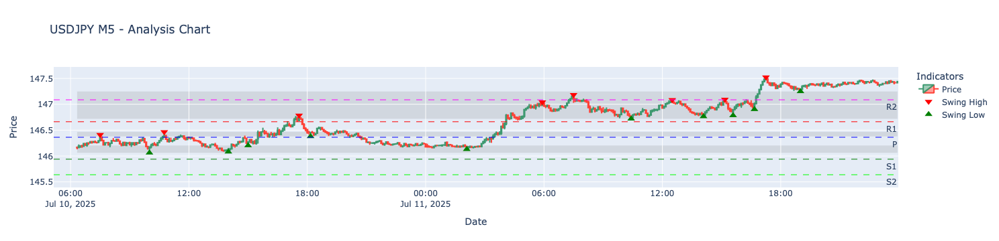

In [41]:
# ==============================================================================
# 4. 分析ロジックの単体テスト
# ==============================================================================
print("【分析ロジックの単体テスト実行】")

if all_data.get(EXECUTION_TIMEFRAME) is not None:
    # ANALYSIS_CANDLES分のデータを切り取って分析
    df_for_test = all_data[EXECUTION_TIMEFRAME].tail(ANALYSIS_CANDLES)

    test_analysis_result = analyze_single_timeframe(df_for_test)

    print("\n--- 分析結果（サマリー）---")
    if test_analysis_result:
        print(f"トレンド方向: {test_analysis_result['environment']['direction']}")
        print(f"トレンド強度: {test_analysis_result['environment']['strength']}")
        print(f"直近のサポート: {test_analysis_result['supports'][:3]}")
        print(f"直近のレジスタンス: {test_analysis_result['resistances'][:3]}")

        print("\n--- 分析結果（グラフ）---")
        plot_analysis_chart(df_for_test, test_analysis_result['details_for_plot'], EXECUTION_TIMEFRAME)
    else:
        print("分析に必要なデータが不足しています。")
else:
    print("実行時間足のデータがないため、テストをスキップしました。")

バックテスト期間: 2025-01-01 11:55:00+00:00 から 2025-07-11 23:55:00+00:00 まで
対象ローソク足の本数: 31675 本

【バックテストメインループ開始: 31675本】


/tmp/ipykernel_20181/741598818.py:305: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



Backtesting Progress:   0%|          | 0/31175 [00:00<?, ?it/s]


==================== デバッグレポート ====================
【エントリー内訳】
  - Sell (Trailing): 63 回
  - Buy (Fixed): 112 回
  - Sell (Fixed): 108 回
  - Buy (Trailing): 45 回

【決済理由内訳】
  - Stop Loss: 279 回
  - Take Profit: 48 回

【ポートフォリオ パフォーマンスレポート】
Start                         2025-01-01 11:55:00+00:00
End                           2025-07-11 23:55:00+00:00
Period                                109 days 23:35:00
Start Value                                   1000000.0
End Value                                1021290.563728
Total Return [%]                               2.129056
Benchmark Return [%]                           -6.19974
Max Gross Exposure [%]                         10.03365
Total Fees Paid                                     0.0
Max Drawdown [%]                               0.902479
Max Drawdown Duration                  34 days 01:45:00
Total Trades                                        328
Total Closed Trades                                 327
Total Open Trades                   

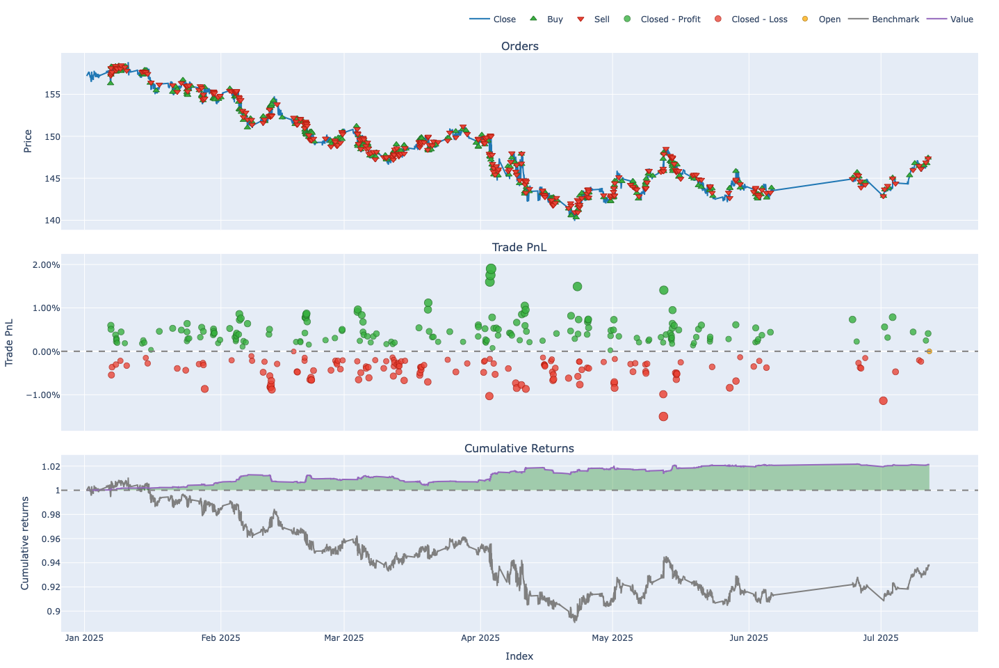

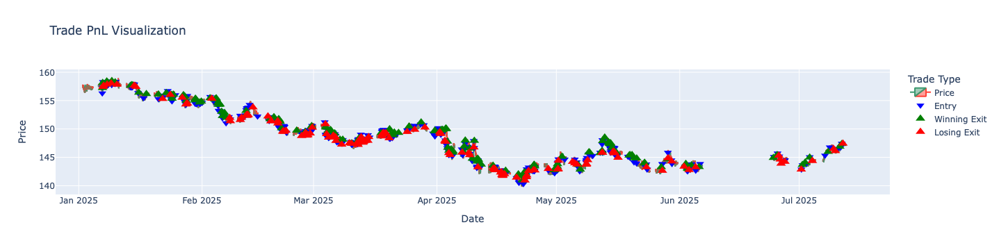

In [ ]:
# ==============================================================================
# 5. バックテストの完全実行とパフォーマンス評価
# ==============================================================================
if all_data.get(EXECUTION_TIMEFRAME) is None:
    print(f"{EXECUTION_TIMEFRAME}のデータが見つからないため、処理を終了します。")
else:
    # --- 指定した日付でデータをフィルタリング ---
    full_df_exec = all_data[EXECUTION_TIMEFRAME]

    # utc=True を追加して、タイムゾーンをUTCに設定
    start_date = pd.to_datetime(BACKTEST_START_DATE, utc=True)

    if BACKTEST_END_DATE is None:
        end_date = full_df_exec.index[-1]
    else:
        # utc=True を追加して、タイムゾーンをUTCに設定
        end_date = pd.to_datetime(BACKTEST_END_DATE, utc=True)

    # バックテスト対象期間のデータを日付で切り出す
    df_exec_filtered = full_df_exec.loc[start_date:end_date]

    print(f"バックテスト期間: {df_exec_filtered.index[0]} から {df_exec_filtered.index[-1]} まで")
    print(f"対象ローソク足の本数: {len(df_exec_filtered)} 本")

    if len(df_exec_filtered) < ANALYSIS_CANDLES:
        print("エラー: バックテスト期間が分析に必要なローソク足の本数に満たないため、処理を中断します。")
    else:
        # --- バックテスト実行 ---
        entries, exits = run_backtest(df_exec_filtered, all_data)

        # --- 結果集計・表示 ---
        if entries.any():
            portfolio = vbt.Portfolio.from_signals(
                df_exec_filtered['close'],
                entries=entries,
                exits=exits,
                freq=FREQ_MAPPING[EXECUTION_TIMEFRAME],
                init_cash=INITIAL_CAPITAL,
                size=ORDER_SIZE_USD,
                size_type='value'
            )

            print("\n" + "="*50)
            print("【ポートフォリオ パフォーマンスレポート】")
            print(portfolio.stats())
            print("="*50)
            portfolio.plot().show()
            plot_trades_with_pnl(portfolio, df_exec_filtered)
        else:
            print("\nエントリーシグナルが発生しなかったため、ポートフォリオは計算されませんでした。")

print("\n【バックテスト完了】")